# Notebook to run basic analysis on processed data after cellbender - FPR 0.05, Ambient Model

**Created by :** Srivalli Kolla

**Created on :** 12 August, 2024

**Modified on :** 31 August, 2024

**Institute of SystemsImmunology, University of Würuburg**

Env : scanpy(Python 3.12.4)

# Importing packages

In [1]:
import anndata as ad
import scanpy as sc
import bbknn
import os
import datetime
import numba
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from scipy.stats import median_abs_deviation

In [2]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 300, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'svg')

timestamp = datetime.datetime.now().strftime("%d_%m_%y")

-----
anndata     0.10.8
scanpy      1.10.1
-----
PIL                 10.3.0
annoy               NA
asttokens           NA
bbknn               1.6.0
cffi                1.16.0
charset_normalizer  3.3.2
colorama            0.4.6
comm                0.2.2
cycler              0.12.1
cython_runtime      NA
dateutil            2.9.0.post0
debugpy             1.8.2
decorator           5.1.1
defusedxml          0.7.1
django              5.0.6
executing           2.0.1
h5py                3.11.0
igraph              0.11.5
ipykernel           6.29.5
ipython_genutils    0.2.0
ipywidgets          8.1.3
jedi                0.19.1
joblib              1.4.2
kiwisolver          1.4.5
legacy_api_wrap     NA
leidenalg           0.10.2
llvmlite            0.43.0
matplotlib          3.8.4
mpl_toolkits        NA
natsort             8.4.0
numba               0.60.0
numexpr             2.10.1
numpy               2.0.0
packaging           24.1
pandas              2.2.2
parso               0.8.4
patsy        

In [3]:
ref = sc.read_h5ad('../../data/annotated_dmd_ref_filtered_dmd_31_08_24.h5ad')
ref

AnnData object with n_obs × n_vars = 117208 × 7000
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'cell_type-broad'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'cell_type-broad_colors', 'hvg', 'neighbors', 'pca', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [4]:
sample_dirs = ['A9_2', 'A10_2', 'A11_2', 'A12_2','B1_2', 'B2_2']
cellbender_data = '../../cellbender/0.05_ambient/'

cellbender_file_paths = [os.path.join(cellbender_data, sample, f"{sample}_filtered.h5") for sample in sample_dirs]

In [5]:
processed_data = [sc.read_10x_h5(file_path) for file_path in cellbender_file_paths]

for after_cb in processed_data:
    after_cb.var_names_make_unique()

after_cb = ad.concat(processed_data, keys= sample_dirs, label= 'sample')
after_cb

reading ../../cellbender/0.05_ambient/A9_2/A9_2_filtered.h5
 (0:00:00)
reading ../../cellbender/0.05_ambient/A10_2/A10_2_filtered.h5


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:00)
reading ../../cellbender/0.05_ambient/A11_2/A11_2_filtered.h5


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:00)
reading ../../cellbender/0.05_ambient/A12_2/A12_2_filtered.h5


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:00)
reading ../../cellbender/0.05_ambient/B1_2/B1_2_filtered.h5


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:00)
reading ../../cellbender/0.05_ambient/B2_2/B2_2_filtered.h5


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:00)


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 188636 × 32285
    obs: 'sample'

In [6]:
after_cb.obs

,sample
CTTCAATCAATAGTCC-1,A9_2
GATGCTAAGCAGTAAT-1,A9_2
GCTACCTAGGTTGGTG-1,A9_2
GATTCTTCACACCTTC-1,A9_2
TAAGCCACATGAGAAT-1,A9_2
...,...
CTCATGCAGGTTGTTC-1,B2_2
TGATTCTTCTTGATTC-1,B2_2
TACGGTATCCCTCTTC-1,B2_2
CCTCCAATCCGATAAC-1,B2_2


In [7]:
after_cb.write_h5ad(f'../../cellbender/0.05_ambient/merged_cb_0.05_fpr_ambient_{timestamp}.h5ad')

In [8]:
after_cb  = sc.read_h5ad(f'../../cellbender/0.05_ambient/merged_cb_0.05_fpr_ambient_{timestamp}.h5ad') 
after_cb

/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 188636 × 32285
    obs: 'sample'

In [9]:
after_cb.obs_names_make_unique()
after_cb

AnnData object with n_obs × n_vars = 188636 × 32285
    obs: 'sample'

In [10]:
def X_is_raw(after_cb):
    return np.array_equal(after_cb.X.sum(axis=0).astype(int), after_cb.X.sum(axis=0))

is_raw = X_is_raw(after_cb)
print(is_raw)

True


In [11]:
after_cb.var["mt"] = after_cb.var_names.str.startswith("Mt-")

after_cb.var["ribo"] = after_cb.var_names.str.startswith(("Rps", "Rpl"))

In [12]:
sc.pp.calculate_qc_metrics(
    after_cb, qc_vars=["mt", "ribo"], inplace=True, percent_top=[20],log1p=True)
after_cb

AnnData object with n_obs × n_vars = 188636 × 32285
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [13]:
def is_outlier(after_cb, metric: str, nmads: int):
    M = after_cb.obs[metric]
    outlier = (M < np.median(M) - nmads * median_abs_deviation(M)) | (
        np.median(M) + nmads * median_abs_deviation(M) < M
    )
    return outlier

In [14]:
after_cb.obs["outlier"] = (
    is_outlier(after_cb, "log1p_total_counts", 5)
    | is_outlier(after_cb, "log1p_n_genes_by_counts", 5)
    | is_outlier(after_cb, "pct_counts_in_top_20_genes", 5)
)
after_cb.obs.outlier.value_counts()

outlier
False    181388
True       7248
Name: count, dtype: int64

In [15]:
print(f"Total number of cells: {after_cb.n_obs}")
after_cb = after_cb[(~after_cb.obs.outlier)].copy()

print(f"Number of cells after filtering of low quality cells: {after_cb.n_obs}")

Total number of cells: 188636
Number of cells after filtering of low quality cells: 181388


In [16]:
sc.pp.normalize_total(after_cb, target_sum= 1e6)
sc.pp.log1p(after_cb)
after_cb.layers["normalized"] = after_cb.X.copy()

normalizing counts per cell
    finished (0:00:00)


In [17]:
sc.pp.highly_variable_genes(after_cb,flavor = "seurat_v3",n_top_genes = 7000,batch_key = "sample",subset = True)
after_cb

extracting highly variable genes


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/scanpy/preprocessing/_highly_variable_genes.py:72: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


AnnData object with n_obs × n_vars = 181388 × 7000
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'hvg'
    layers: 'normalized'

In [18]:
sc.pp.pca(after_cb, n_comps = 50, use_highly_variable = True, svd_solver = 'arpack', random_state = 1712)
sc.pp.neighbors(after_cb, use_rep = "X_pca", n_neighbors = 50, metric = 'minkowski', random_state = 1786)

computing PCA
    with n_comps=50


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


    finished (0:00:21)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:13)


In [19]:
bbknn_donor = bbknn.bbknn(after_cb, 
    batch_key = "sample", copy = True)
bbknn_donor

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:14)


AnnData object with n_obs × n_vars = 181388 × 7000
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'hvg', 'pca', 'neighbors'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'normalized'
    obsp: 'distances', 'connectivities'

In [20]:
ref.obs.index

Index(['ACACTGATCATTATCC-1-A9_2', 'TCTTCCTGTCATAACC-1-A9_2',
       'ATCTCTAGTTTCAGAC-1-A9_2', 'TGAATGCAGCTCCATA-1-A9_2',
       'GCAGCTGCACAAGTGG-1-A9_2', 'GAGACTTCAGTTAGAA-1-A9_2',
       'CCGATCTTCGCACGGT-1-A9_2', 'TAACTTCTCACAGAGG-1-A9_2',
       'CAACGATGTCTACGTA-1-A9_2', 'ATCGATGGTACCTAGT-1-A9_2',
       ...
       'TGACCCTAGCACCTGC-1-A12_2', 'CCGGACAGTAGCGCTC-1-A12_2',
       'ATTCGTTTCACGTCCT-1-A12_2', 'GTCTCACAGTGTTCAC-1-A12_2',
       'CATAAGCAGTGTCATC-1-A12_2', 'GGTGATTCACCATATG-1-A12_2',
       'TGGTAGTTCATTCGTT-1-A12_2', 'CAACCTCGTGCATTAC-1-A12_2',
       'GTGTGGCAGAAATCCA-1-A12_2', 'CACTGGGTCAACGAGG-1-A12_2'],
      dtype='object', length=117208)

In [21]:
bbknn_donor.obs.index

Index(['CCAAGCGAGGCACCAA-1', 'GTGGAAGGTCTCCTGT-1', 'TAGACTGGTAGAGATT-1',
       'CAGGGCTTCGCGTAGC-1', 'GGGTTATGTACTTGTG-1', 'CGATGCGGTCCTGAAT-1',
       'TTTACTGAGTAGCATA-1', 'TGTTCATAGGCAGTCA-1', 'CCCTTAGGTGCCCGTA-1',
       'ACGGAAGCACCCTTAC-1',
       ...
       'GCGATCGTCAAGCCCG-1', 'CAGATCACAATTAGGA-1', 'CCTTCAGAGGTTCTAC-1',
       'TCCTCCCTCTTCTTCC-1-3', 'TCCTTCTTCTTTCTTC-1-1', 'ACCGTTCTCTACTATC-1',
       'TTCTCTCTCCCTCTCT-1-1', 'CTATAGGTCATCACTC-1', 'ACGGTTACAGCGTACC-1',
       'AGCGTCGTCTCGCAGG-1'],
      dtype='object', length=181388)

In [22]:
ref_barcodes = pd.DataFrame(ref.obs.index, columns= ['barcodes'])
ref_barcodes

,barcodes
0,ACACTGATCATTATCC-1-A9_2
1,TCTTCCTGTCATAACC-1-A9_2
2,ATCTCTAGTTTCAGAC-1-A9_2
3,TGAATGCAGCTCCATA-1-A9_2
4,GCAGCTGCACAAGTGG-1-A9_2
...,...
117203,GGTGATTCACCATATG-1-A12_2
117204,TGGTAGTTCATTCGTT-1-A12_2
117205,CAACCTCGTGCATTAC-1-A12_2
117206,GTGTGGCAGAAATCCA-1-A12_2


In [23]:
def clean_ref(barcode):
    return barcode.rsplit('-', 1)[0] 

In [24]:
ref_barcodes['cleaned_barcodes'] = ref_barcodes['barcodes'].apply(clean_ref)
ref_barcodes['cell_type-broad'] = ref.obs['cell_type-broad'].values
ref_barcodes

,barcodes,cleaned_barcodes,cell_type-broad
0,ACACTGATCATTATCC-1-A9_2,ACACTGATCATTATCC-1,cardiomyocytes
1,TCTTCCTGTCATAACC-1-A9_2,TCTTCCTGTCATAACC-1,cardiomyocytes
2,ATCTCTAGTTTCAGAC-1-A9_2,ATCTCTAGTTTCAGAC-1,cardiomyocytes
3,TGAATGCAGCTCCATA-1-A9_2,TGAATGCAGCTCCATA-1,cardiomyocytes
4,GCAGCTGCACAAGTGG-1-A9_2,GCAGCTGCACAAGTGG-1,cardiomyocytes
...,...,...,...
117203,GGTGATTCACCATATG-1-A12_2,GGTGATTCACCATATG-1,myeloid
117204,TGGTAGTTCATTCGTT-1-A12_2,TGGTAGTTCATTCGTT-1,myeloid
117205,CAACCTCGTGCATTAC-1-A12_2,CAACCTCGTGCATTAC-1,myeloid
117206,GTGTGGCAGAAATCCA-1-A12_2,GTGTGGCAGAAATCCA-1,myeloid


In [25]:
bbknn_donor_barcodes = pd.DataFrame(after_cb.obs.index, columns= ['barcodes'])
bbknn_donor_barcodes

,barcodes
0,CCAAGCGAGGCACCAA-1
1,GTGGAAGGTCTCCTGT-1
2,TAGACTGGTAGAGATT-1
3,CAGGGCTTCGCGTAGC-1
4,GGGTTATGTACTTGTG-1
...,...
181383,ACCGTTCTCTACTATC-1
181384,TTCTCTCTCCCTCTCT-1-1
181385,CTATAGGTCATCACTC-1
181386,ACGGTTACAGCGTACC-1


In [26]:
mapping_dict = pd.Series(ref_barcodes['cell_type-broad'].values, index=ref_barcodes['cleaned_barcodes']).to_dict()
mapping_dict

{'ACACTGATCATTATCC-1': 'cardiomyocytes',
 'TCTTCCTGTCATAACC-1': 'cardiomyocytes',
 'ATCTCTAGTTTCAGAC-1': 'cardiomyocytes',
 'TGAATGCAGCTCCATA-1': 'cardiomyocytes',
 'GCAGCTGCACAAGTGG-1': 'cardiomyocytes',
 'GAGACTTCAGTTAGAA-1': 'cardiomyocytes',
 'CCGATCTTCGCACGGT-1': 'cardiomyocytes',
 'TAACTTCTCACAGAGG-1': 'cardiomyocytes',
 'CAACGATGTCTACGTA-1': 'cardiomyocytes',
 'ATCGATGGTACCTAGT-1': 'cardiomyocytes',
 'TTTGGTTCATCAACCA-1': 'cardiomyocytes',
 'AATCGTGAGAATTTGG-1': 'cardiomyocytes',
 'CTTCCGAGTCCCAAAT-1': 'cardiomyocytes',
 'AATTCCTTCACCGACG-1': 'cardiomyocytes',
 'TAGAGTCCACACCTTC-1': 'cardiomyocytes',
 'ATTCACTTCCTCACTG-1': 'cardiomyocytes',
 'GTTCCGTTCCCTCGTA-1': 'cardiomyocytes',
 'GACGTTAAGGAAAGGT-1': 'cardiomyocytes',
 'TCACATTCATTCACCC-1': 'cardiomyocytes',
 'CATTGCCCACGACGCT-1': 'cardiomyocytes',
 'GATCACATCGCTTAAG-1': 'lymphoid',
 'AACCTGAGTCACTCAA-1': 'cardiomyocytes',
 'CTACTATGTAGCGATG-1': 'cardiomyocytes',
 'CACAACATCGTTCTAT-1': 'cardiomyocytes',
 'GTGAGCCAGACGTCCC-1':

In [27]:
bbknn_donor_barcodes['cell_type-broad'] = bbknn_donor_barcodes['barcodes'].map(mapping_dict).fillna('Unknown')

bbknn_donor.obs['cell_type-broad'] = bbknn_donor_barcodes['cell_type-broad'].values

bbknn_donor.obs['cell_type-broad'].value_counts()

cell_type-broad
Unknown            79696
lymphoid           58169
vascular states    21351
fibroblasts         8794
myeloid             7355
cardiomyocytes      6023
Name: count, dtype: int64

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:29)


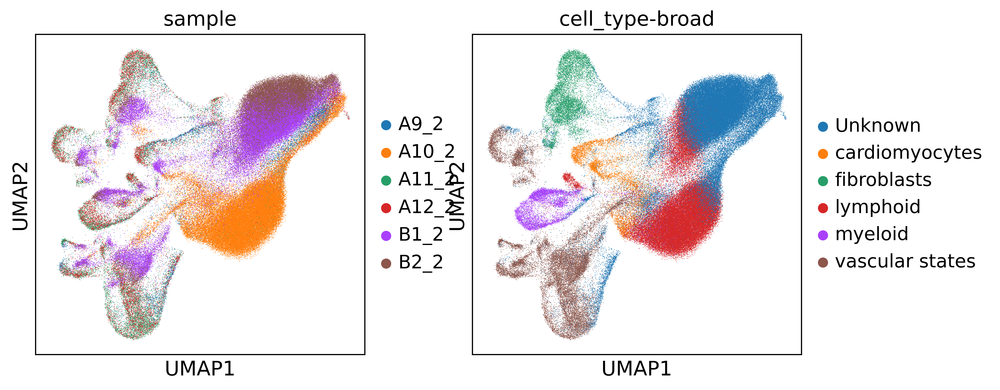

In [28]:
sc.tl.umap(bbknn_donor)
sc.pl.umap(bbknn_donor, color= ['sample','cell_type-broad'])

In [29]:
genes_of_interest = ['Il2','Tnnt2','Il10', 'Ttn','Dcn','Myh7', 'Dmd','Ctnna3','Lama2','Ryr2', 'Cd44']

present_genes = [gene for gene in genes_of_interest if gene in bbknn_donor.var.index]

In [30]:
sc.pl.umap(bbknn_donor, color = present_genes)

In [31]:
after_cb_interested = bbknn_donor[:, present_genes].X.sum(axis=0).A1

counts_df = pd.DataFrame({'Gene': present_genes, 'Total Count': after_cb_interested})
counts_df

,Gene,Total Count
0,Il2,5.466769e+02
1,Tnnt2,1.077366e+06
2,Il10,3.992059e+02
3,Ttn,8.176668e+05
4,Dcn,7.396930e+05
5,Myh7,8.636997e+04
6,Dmd,1.893157e+05
7,Ctnna3,9.331762e+04
8,Lama2,2.095799e+05
9,Ryr2,3.262865e+05


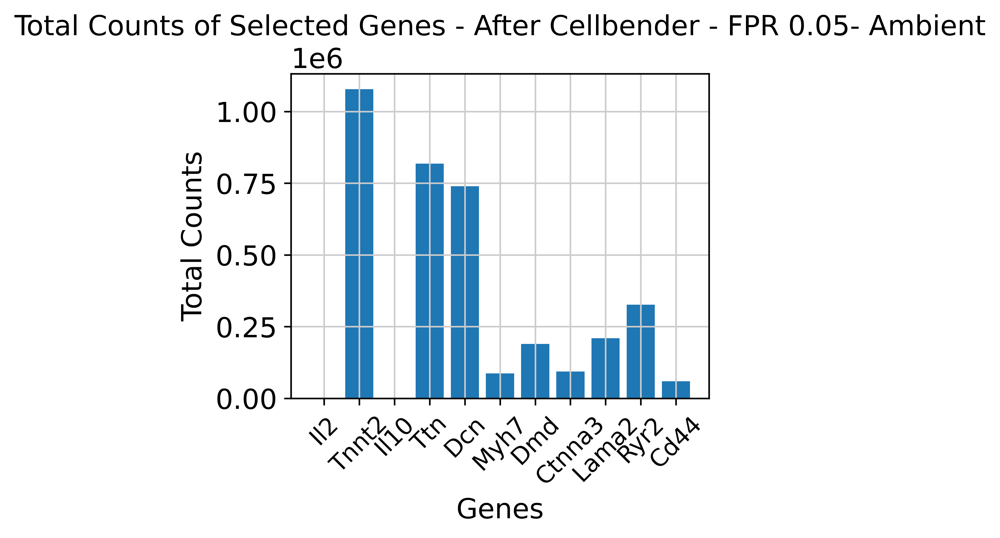

In [32]:
plt.bar(counts_df['Gene'], counts_df['Total Count'])
plt.title('Total Counts of Selected Genes - After Cellbender - FPR 0.05- Ambient')
plt.xlabel('Genes')
plt.ylabel('Total Counts')
plt.xticks(rotation=45, fontsize = 12)
plt.tight_layout()
plt.show()

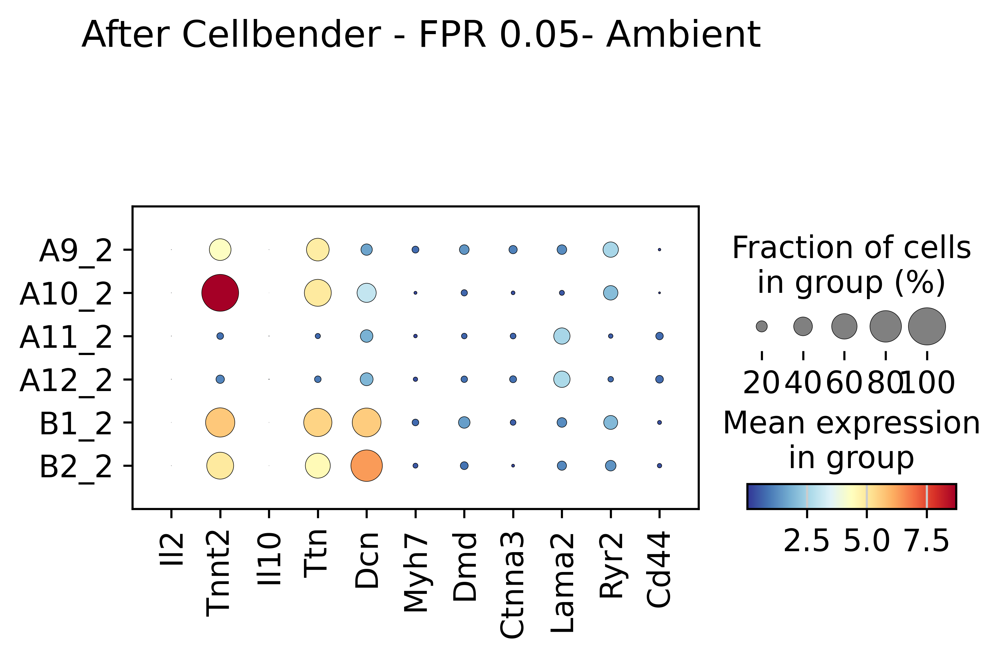

In [33]:
sc.pl.dotplot(bbknn_donor, var_names= present_genes, groupby= 'sample', cmap= 'RdYlBu_r', title= ' After Cellbender - FPR 0.05- Ambient')

In [34]:
sc.pl.violin(bbknn_donor, keys= present_genes, groupby= 'sample',cmap= 'RdYlBu_r', rotation= 45)

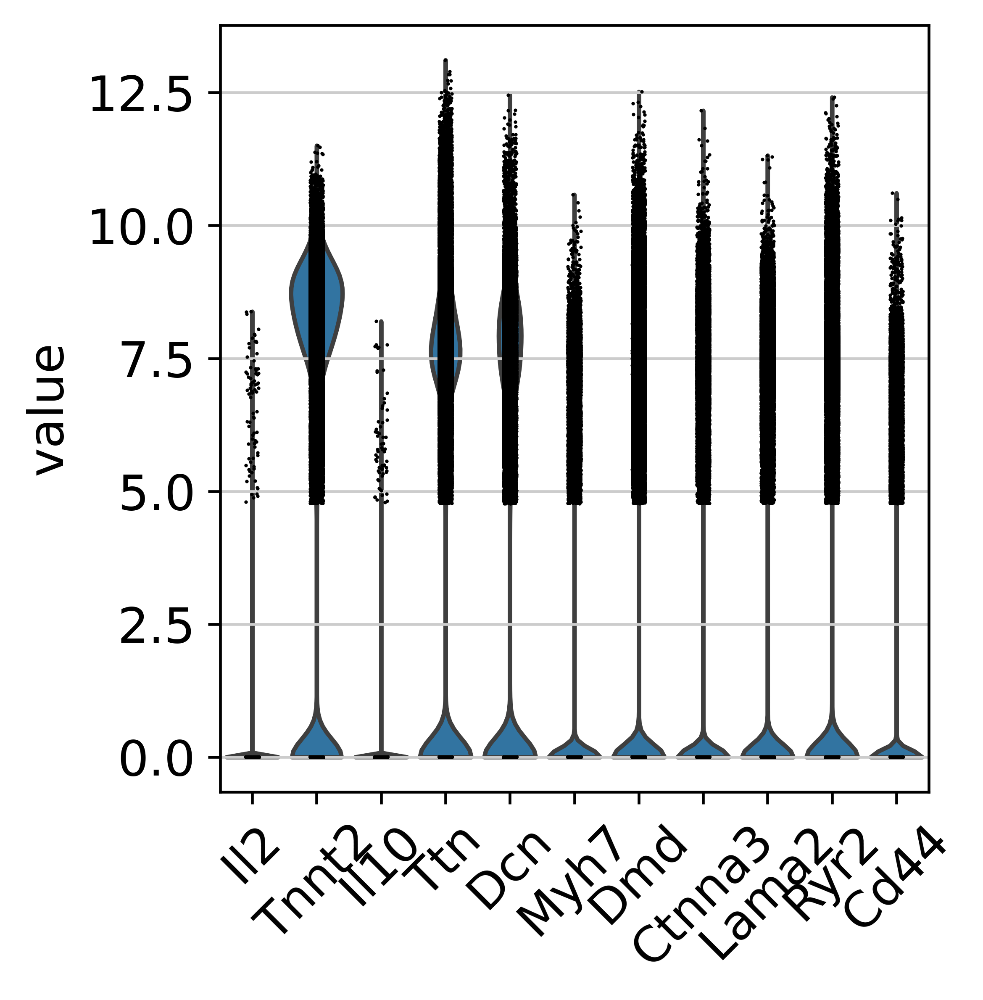

In [35]:
sc.pl.violin(bbknn_donor, keys= present_genes,cmap= 'RdYlBu_r', rotation= 45)

In [36]:
sorted(bbknn_donor.var_names[bbknn_donor.var_names.str.startswith('Cd')])

['Cd151',
 'Cd163',
 'Cd163l1',
 'Cd164l2',
 'Cd177',
 'Cd180',
 'Cd19',
 'Cd2',
 'Cd200',
 'Cd200r2',
 'Cd207',
 'Cd209a',
 'Cd209b',
 'Cd209c',
 'Cd209d',
 'Cd209g',
 'Cd226',
 'Cd244a',
 'Cd247',
 'Cd248',
 'Cd24a',
 'Cd300a',
 'Cd300c',
 'Cd300c2',
 'Cd300e',
 'Cd300lb',
 'Cd300lf',
 'Cd300lg',
 'Cd33',
 'Cd36',
 'Cd37',
 'Cd38',
 'Cd3d',
 'Cd3e',
 'Cd3g',
 'Cd44',
 'Cd52',
 'Cd53',
 'Cd55b',
 'Cd59a',
 'Cd5l',
 'Cd6',
 'Cd68',
 'Cd69',
 'Cd7',
 'Cd74',
 'Cd79a',
 'Cd79b',
 'Cd84',
 'Cd86',
 'Cd8a',
 'Cd96',
 'Cdc25c',
 'Cdc34',
 'Cdca5',
 'Cdca7l',
 'Cdcp1',
 'Cdcp2',
 'Cdh1',
 'Cdh10',
 'Cdh11',
 'Cdh12',
 'Cdh13',
 'Cdh15',
 'Cdh16',
 'Cdh19',
 'Cdh2',
 'Cdh20',
 'Cdh23',
 'Cdh26',
 'Cdh6',
 'Cdh7',
 'Cdh8',
 'Cdh9',
 'Cdhr4',
 'Cdhr5',
 'Cdk1',
 'Cdk14',
 'Cdk19os',
 'Cdk8',
 'Cdkl1',
 'Cdkn1c',
 'Cdkn2a',
 'Cdkn2b',
 'Cdkn2d',
 'Cdkn3',
 'Cdnf',
 'Cdrt4os1',
 'Cdsn']

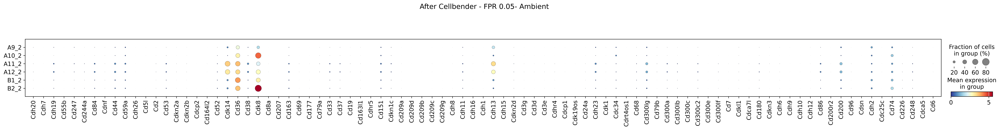

In [37]:
sc.pl.dotplot(bbknn_donor, var_names=(bbknn_donor.var_names[bbknn_donor.var_names.str.startswith('Cd')]), groupby= 'sample', cmap= 'RdYlBu_r', title= ' After Cellbender - FPR 0.05- Ambient')

In [38]:
ref_log_expr = ref.X
cb_log_expr = bbknn_donor.X

In [39]:
ref_mean_log_expr = np.mean(ref_log_expr,axis=0)
cb_mean_log_expr = np.mean(cb_log_expr,axis=0)

In [40]:
log_fc = cb_mean_log_expr - ref_mean_log_expr
log_fc.shape

(1, 7000)

In [41]:
log_fc = np.asarray(log_fc)
log_fc = log_fc.flatten()
log_fc.shape

(7000,)

In [42]:
log_fc_df = pd.DataFrame({'Gene': ref.var_names, 'LogFC': log_fc})

log_fc_df

,Gene,LogFC
0,Xkr4,-0.044621
1,Rp1,0.099613
2,Sox17,0.198860
3,Rgs20,-0.023882
4,Oprk1,0.001090
...,...,...
6995,Frmpd4,-0.011356
6996,Arhgap6,-1.076286
6997,Mid1,-0.865688
6998,Usp9y,-0.008349


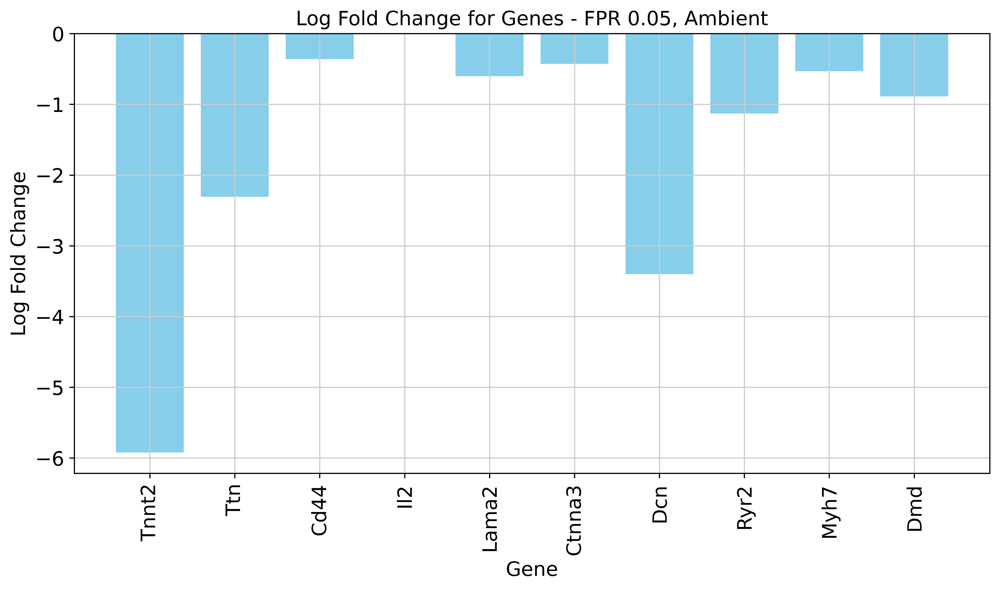

In [43]:
present_genes_set = set(present_genes)

filtered_log_fc_df = log_fc_df[log_fc_df['Gene'].isin(present_genes_set)]

plt.figure(figsize=(10, 6))
plt.bar(filtered_log_fc_df['Gene'], filtered_log_fc_df['LogFC'], color='skyblue')
plt.xlabel('Gene')
plt.ylabel('Log Fold Change')
plt.title('Log Fold Change for Genes - FPR 0.05, Ambient')
plt.xticks(rotation=90)  
plt.tight_layout()
plt.show()